In [ ]:
import os
from typing import Tuple, List, Dict, Any

import dask.array as da
import numpy as np
import torch
import torch.nn.functional as F
import cv2
from PIL import Image
import torch.multiprocessing as mp


import omnialigner as om
from omnialigner.utils.tiles import merge_from_overlapped_tiles
from omnialigner.utils.image_viz import rgb_he_to_gray
from omnialigner.utils.field_transform import grid_2d_to_disp_field, disp_field_to_grid_2d
from omnialigner.utils.grid_sample import mp_array_grid_sample

%load_ext autoreload
%autoreload 2



# mp.set_start_method('spawn')



detector = om.kp.init_detector("roma")
plt = om.pl.plt


def generate_tiles(
        np_kpts: np.ndarray,
        tile_size=2048,
        extend_ratio=0.1,
        threshold_tile=10,
        max_size: Tuple[int, int] = (16000, 16000)
    ):
    extend_len = int(tile_size * extend_ratio / 2)
    l_tiles = []
    l_tiles_extend = []
    l_masks = []
    
    kpt_up_left = np_kpts.min(axis=0).astype(int)
    kpt_down_right = np_kpts.max(axis=0).astype(int)
    print(f"Keypoints bounding box: {kpt_up_left}, {kpt_down_right}")
    for y_beg in range(kpt_up_left[1], kpt_down_right[1], tile_size):
        for x_beg in range(kpt_up_left[0], kpt_down_right[0], tile_size):
            x_beg = max(x_beg, 0)
            y_beg = max(y_beg, 0)
            x_end = min(x_beg + tile_size, max_size[0])
            y_end = min(y_beg + tile_size, max_size[1])
            np_selected = np_kpts[
                (np_kpts[:, 1] >= y_beg) & (np_kpts[:, 1] < y_end) &
                (np_kpts[:, 0] >= x_beg) & (np_kpts[:, 0] < x_end)
            ]
            n_selected = np_selected.shape[0]
            if n_selected < threshold_tile:
                print(f"too few keypoints(n={n_selected}) in tile({x_beg}, {y_beg}), skipping")
                continue
            
            x_beg_extend = max(x_beg - extend_len, 0)
            y_beg_extend = max(y_beg - extend_len, 0)
            x_end_extend = min(x_beg + tile_size + extend_len, max_size[0])
            y_end_extend = min(y_beg + tile_size + extend_len, max_size[1])
            l_tiles.append([x_beg, y_beg, x_end, y_end])
            l_tiles_extend.append([x_beg_extend, y_beg_extend, x_end_extend, y_end_extend])
            l_masks.append(n_selected)

    return l_tiles, l_tiles_extend, l_masks


def refine_tile(da_ref, da_query, crop_region):
    x_beg, y_beg, x_end, y_end = crop_region
    h, w = y_end - y_beg, x_end - x_beg
    da_ref_roi = np.repeat(da_ref[y_beg:y_end, x_beg:x_end], 3, 2)
    da_query_roi = np.repeat(da_query[y_beg:y_end, x_beg:x_end, 0:1], 3, 2)

    tensor_ref_roi = om.tl.im2tensor(da_ref_roi)
    tensor_query_roi = om.tl.im2tensor(da_query_roi)

    mkpt_F, mkpt_M, _,roma_model = om.kp.match(tensor_ref_roi, tensor_query_roi, detector=detector)
    kd = om.kp.KeypointPairs(
        image_F=tensor_ref_roi,
        image_M=tensor_query_roi,
        mkpts_F=mkpt_F,
        mkpts_M=mkpt_M,
        index_matches=range(len(mkpt_F))
    )

    grid_2d = F.interpolate(roma_model[1]["flow"][0:1, :, :, :], size=(tensor_query_roi.shape[2], tensor_query_roi.shape[3]), mode="bilinear", align_corners=True)
    grid_2d = grid_2d.permute(0, 2, 3, 1)
    tensor_moved_roi = F.grid_sample(tensor_query_roi, grid_2d, "bilinear", align_corners=True)
    disp = grid_2d_to_disp_field(grid_2d)
    img_shown = 3*da_ref_roi.compute()
    img_shown[:, :, 2] = om.tl.tensor2im(tensor_moved_roi)[..., 0]
    img_shown[:, :, 1] = 0
    
    cv2.imwrite(f"ovlp_{crop_region[0]}_{crop_region[1]}.png", img_shown)
    return tensor_moved_roi, disp, kd


def show_bbox_on_image(image, bbox_list, labels=None, colors=None, figsize=(12, 8)):
    """
    Show bounding boxes on an image using matplotlib.
    
    Args:
        image: numpy array Image (H, W) 或 (H, W, C)
        bbox_list: list of tuples,  (x_beg, y_beg, x_end, y_end)
        labels: list of str, labels for each bounding box
        colors: list of str, colors for each bounding box
        figsize: tuple, figure size
    """
    import matplotlib.patches as patches
    
    if colors is None:
        colors = ['red', 'blue', 'green', 'orange', 'purple', 'yellow', 'cyan', 'magenta']
    
    while len(colors) < len(bbox_list):
        colors.extend(colors)
    
    fig, ax = plt.subplots(1, 1, figsize=figsize)
    
    if len(image.shape) == 2:
        ax.imshow(image, cmap='gray')
    else:
        ax.imshow(image)
    
    for i, bbox in enumerate(bbox_list):
        x_beg, y_beg, x_end, y_end = bbox
        
        width = x_end - x_beg
        height = y_end - y_beg
        
        rect = patches.Rectangle(
            (x_beg, y_beg), width, height,
            linewidth=2, edgecolor=colors[i % len(colors)], 
            facecolor='none', alpha=0.8
        )
        
        ax.add_patch(rect)
        
        if labels and i < len(labels):
            ax.text(x_beg, y_beg - 10, labels[i], 
                   color=colors[i % len(colors)], fontsize=12, 
                   bbox=dict(boxstyle="round,pad=0.3", facecolor='white', alpha=0.7))
        else:
            ax.text(x_beg, y_beg - 10, f'Box {i}', 
                   color=colors[i % len(colors)], fontsize=12,
                   bbox=dict(boxstyle="round,pad=0.3", facecolor='white', alpha=0.7))
    
    ax.set_title(f'Image with {len(bbox_list)} Bounding Boxes')
    plt.tight_layout()
    plt.show()

Using coarse resolution (560, 560), and upsample res (1024, 1024)


In [26]:
import scanpy as sc

da_ref_raw = om.tl.read_ome_tiff("./raw_HE.ome.tif", l_channels=[0,1,2])
da_query = om.tl.read_ome_tiff("./P3_DAPI.ome.tif")

da_ref = rgb_he_to_gray(da_ref_raw, is_HE=True, **{
    "alpha_he": 1.0,
    "alpha_ihc": 3.0
})

adata = sc.read_h5ad("./single_cell_exp.h5ad")
adata.obsm["spatial"]

array([[ 3427.29055039,  7030.67668446],
       [ 3429.22314244,  7051.95784282],
       [ 3432.32352361,  7052.93914642],
       ...,
       [13481.87855069, 10004.35746403],
       [13483.16512476, 10007.30017236],
       [13478.26352131, 10042.28499725]])

Keypoints bounding box: [3424 5675], [13483 11812]
too few keypoints(n=0) in tile(11616, 5675), skipping


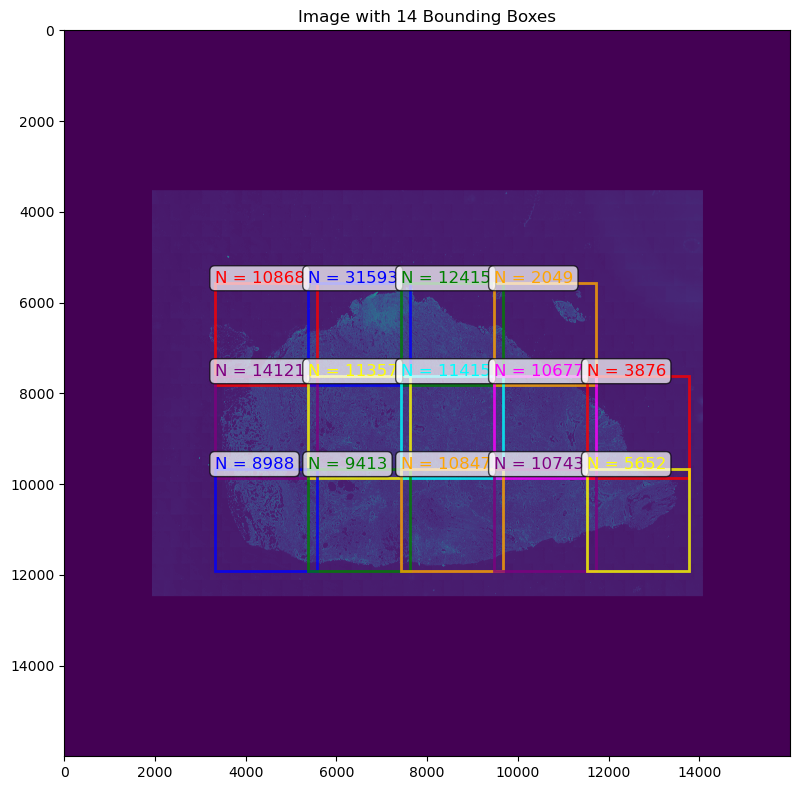

In [3]:
l_tiles, l_tiles_extend, l_masks = generate_tiles(adata.obsm["spatial"], tile_size=2048, extend_ratio=0.1, threshold_tile=0.3)

l_boxes = l_tiles_extend.copy()
show_bbox_on_image(da_ref, l_boxes, labels=[f"N = {l_masks[i]}" for i in range(len(l_boxes))])


# ROI example

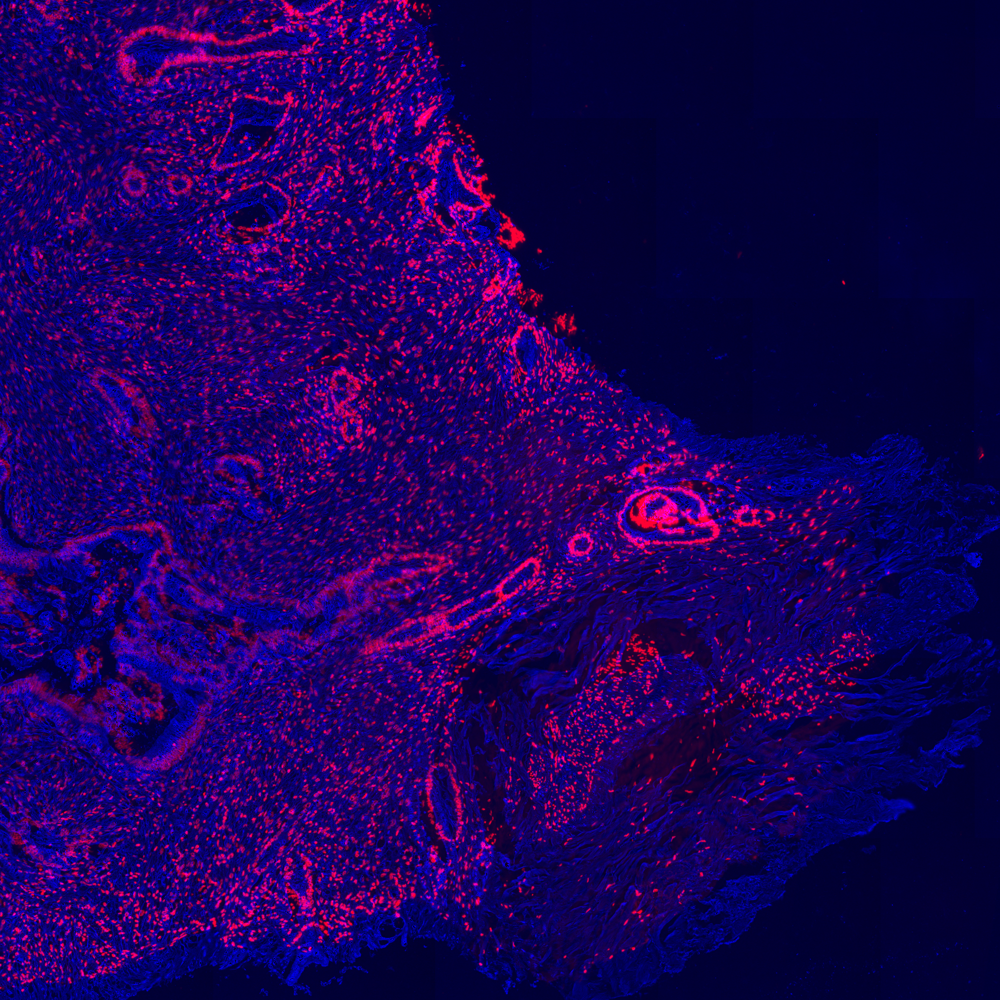

In [4]:
crop_region = (11500, 9000, 13500, 11000)
img_shown = 3*np.repeat(da_ref[crop_region[1]:crop_region[3], crop_region[0]:crop_region[2]], 3, 2)
img_shown[:, :, 0] = da_query[crop_region[1]:crop_region[3], crop_region[0]:crop_region[2], 0]
img_shown[:, :, 1] = 0

Image.fromarray(img_shown.compute())

In [5]:
crop_region = (11500, 9000, 13500, 11000)
tensor_moved_roi, disp, kd = refine_tile(da_ref, da_query, crop_region)
disp.shape


torch.Size([1, 2000, 2000, 2])

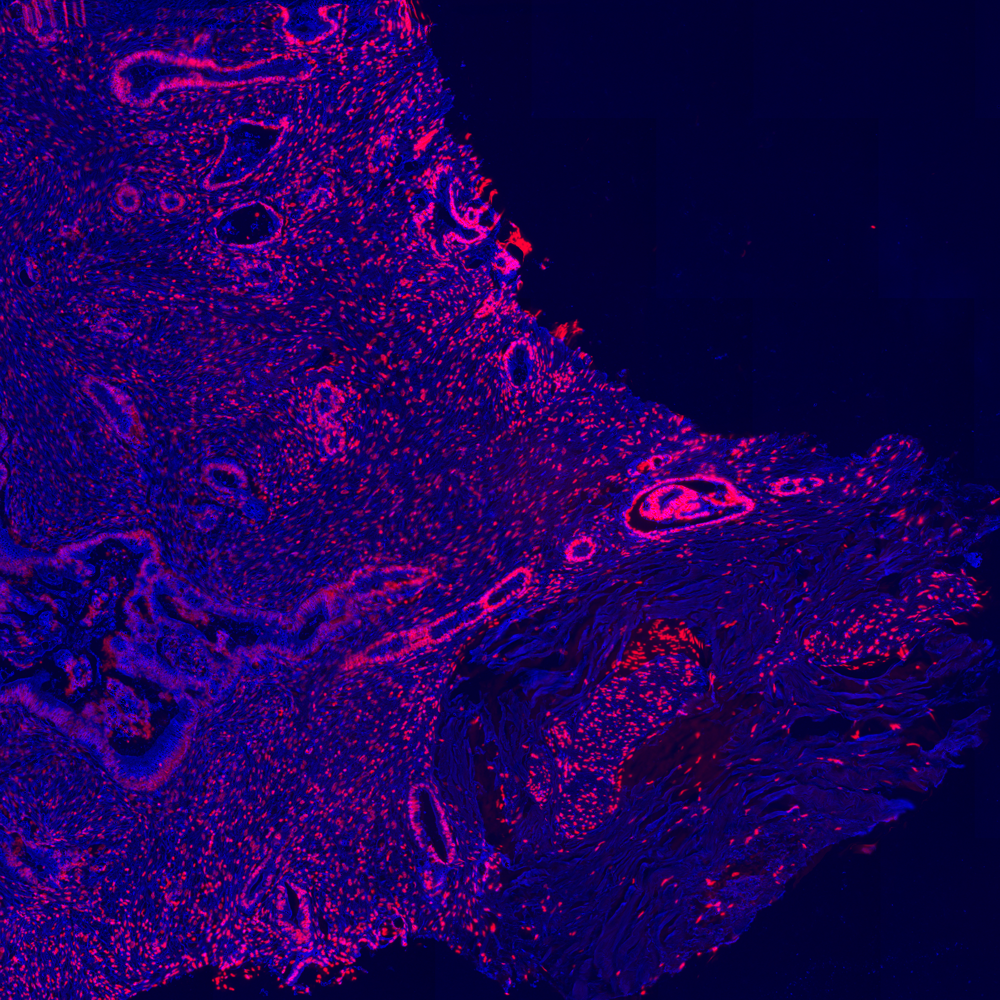

In [6]:


# 使用示例 - 修正你的代码
disp.shape  # [2000, 2000, 1, 2]
da_query_crop = da_query[crop_region[1]:crop_region[3], crop_region[0]:crop_region[2], :].compute()
tensor_query_roi = om.tl.im2tensor(da_query_crop)  # [1, C, H, W]
# grid_ = disp_to_grid(disp)  # [1, H, W, 2]


# from omnialigner.utils.field_transform import disp_to_grid
grid_ = disp_field_to_grid_2d(disp)
img_reg = F.grid_sample(tensor_query_roi, grid_, "bilinear", align_corners=True)  # [1, C, H, W]

img_shown = 3*np.repeat(da_ref[crop_region[1]:crop_region[3], crop_region[0]:crop_region[2]], 3, 2).compute()
img_shown[:, :, 0] = 255*img_reg[0, 0]
img_shown[:, :, 1] = 0

Image.fromarray(img_shown)

# all regions

In [ ]:
crop_region = (11500, 9000, 13500, 11000)
l_boxes += [crop_region]


l_disp = []
for crop_region in l_boxes:
    if not os.path.exists(f"disp_{crop_region[0]}_{crop_region[1]}.pth"):
        tensor_moved_roi, disp, kd = refine_tile(da_ref, da_query, crop_region)
        torch.save(disp, f"disp_{crop_region[0]}_{crop_region[1]}.pth")
        # torch.save(tensor_moved_roi, f"img_{crop_region[0]}_{crop_region[1]}.pth")

    disp = torch.load(f"disp_{crop_region[0]}_{crop_region[1]}.pth")
    l_disp.append(disp)
    print(crop_region, disp.shape, disp.max(), disp.mean())

disp_merged = merge_from_overlapped_tiles(l_boxes, l_disp=l_disp, H=16000, W=16000)

[3322, 5573, 5574, 7825] torch.Size([1, 2252, 2252, 2]) tensor(0.5987) tensor(0.0574)
[5370, 5573, 7622, 7825] torch.Size([1, 2252, 2252, 2]) tensor(0.1871) tensor(0.0050)
[7418, 5573, 9670, 7825] torch.Size([1, 2252, 2252, 2]) tensor(0.3054) tensor(0.0039)
[9466, 5573, 11718, 7825] torch.Size([1, 2252, 2252, 2]) tensor(1.6845) tensor(0.0962)
[3322, 7621, 5574, 9873] torch.Size([1, 2252, 2252, 2]) tensor(0.2740) tensor(0.0011)
[5370, 7621, 7622, 9873] torch.Size([1, 2252, 2252, 2]) tensor(0.5680) tensor(-5.9896e-05)
[7418, 7621, 9670, 9873] torch.Size([1, 2252, 2252, 2]) tensor(0.0904) tensor(-0.0067)
[9466, 7621, 11718, 9873] torch.Size([1, 2252, 2252, 2]) tensor(0.1562) tensor(-0.0037)
[11514, 7621, 13766, 9873] torch.Size([1, 2252, 2252, 2]) tensor(0.3036) tensor(-0.0565)
[3322, 9669, 5574, 11921] torch.Size([1, 2252, 2252, 2]) tensor(0.3432) tensor(-0.0018)
[5370, 9669, 7622, 11921] torch.Size([1, 2252, 2252, 2]) tensor(0.3177) tensor(-0.0593)
[7418, 9669, 9670, 11921] torch.Size([

Processing: 100%|██████████| 256/256 [00:28<00:00,  9.04it/s]


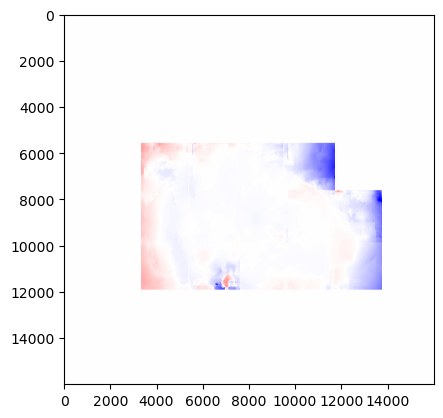

In [8]:

n_cpus = mp.cpu_count()
input_tensor = om.tl.im2tensor(da_query)

grid = disp_field_to_grid_2d(disp_merged.float())

result = mp_array_grid_sample(input_tensor, grid, chunks=(1, 'auto', 1024, 1024), max_workers=n_cpus)

plt.imshow(disp_merged[0, :, :, 0], vmax=0.1, vmin=-0.1, cmap="bwr")

In [36]:
result

dask.array<setitem, shape=(1, 1, 16000, 16000), dtype=float32, chunksize=(1, 1, 1024, 1024), chunktype=numpy.ndarray>

In [29]:
img_result

dask.array<array, shape=(16000, 16000, 3), dtype=uint8, chunksize=(6688, 6688, 3), chunktype=numpy.ndarray>

In [ ]:
## cheese plot for overlapped images

def cheese_plot(da_ref, da_query_aligned, crop_region, chese_boards=(10, 10)):
    x_beg, y_beg, x_end, y_end = crop_region
    h, w = y_end - y_beg, x_end - x_beg
    
    da_ref_roi = da_ref[y_beg:y_end, x_beg:x_end]
    da_query_roi = da_query_aligned[y_beg:y_end, x_beg:x_end]

    img_shown = np.zeros((h, w, 3), dtype=np.uint8)
    img_shown[:, :, 0] = da_ref_roi.compute()
    img_shown[:, :, 1] = da_query_roi.compute()
    
    return Image.fromarray(img_shown)


crop_region = l_boxes[5]
cheese_plot(da_ref, result, crop_region)

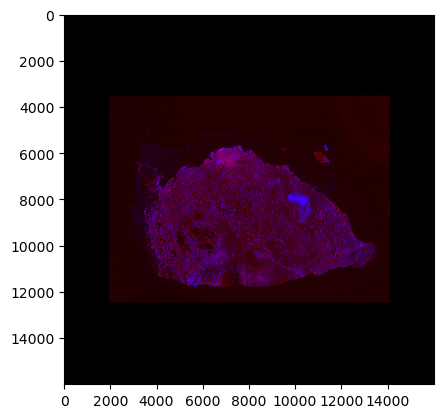

In [9]:
img_result =  3*np.repeat(om.tl.tensor2im(torch.from_numpy(result.compute())), 3, 2)
img_result[:, :, 0] = 2*da_ref[:, :, 0]
img_result[:, :, 1] = 0
plt.imshow(img_result)

Text(0.5, 1.0, 'Crop region: [3322, 5573, 5574, 7825]')

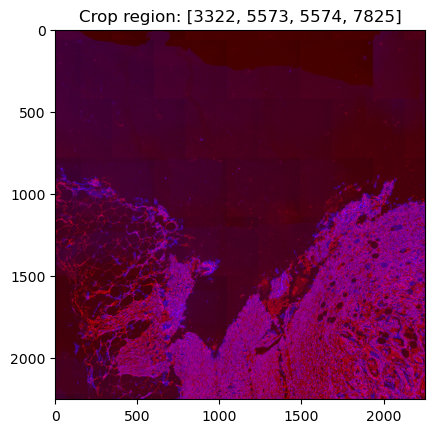

In [10]:
crop_region = l_boxes[0] #(3000, 9000, 5000, 11000)
img_out_roi = img_result[crop_region[1]:crop_region[3], crop_region[0]:crop_region[2]]
plt.imshow(2*img_out_roi)
plt.title(f"Crop region: {crop_region}")

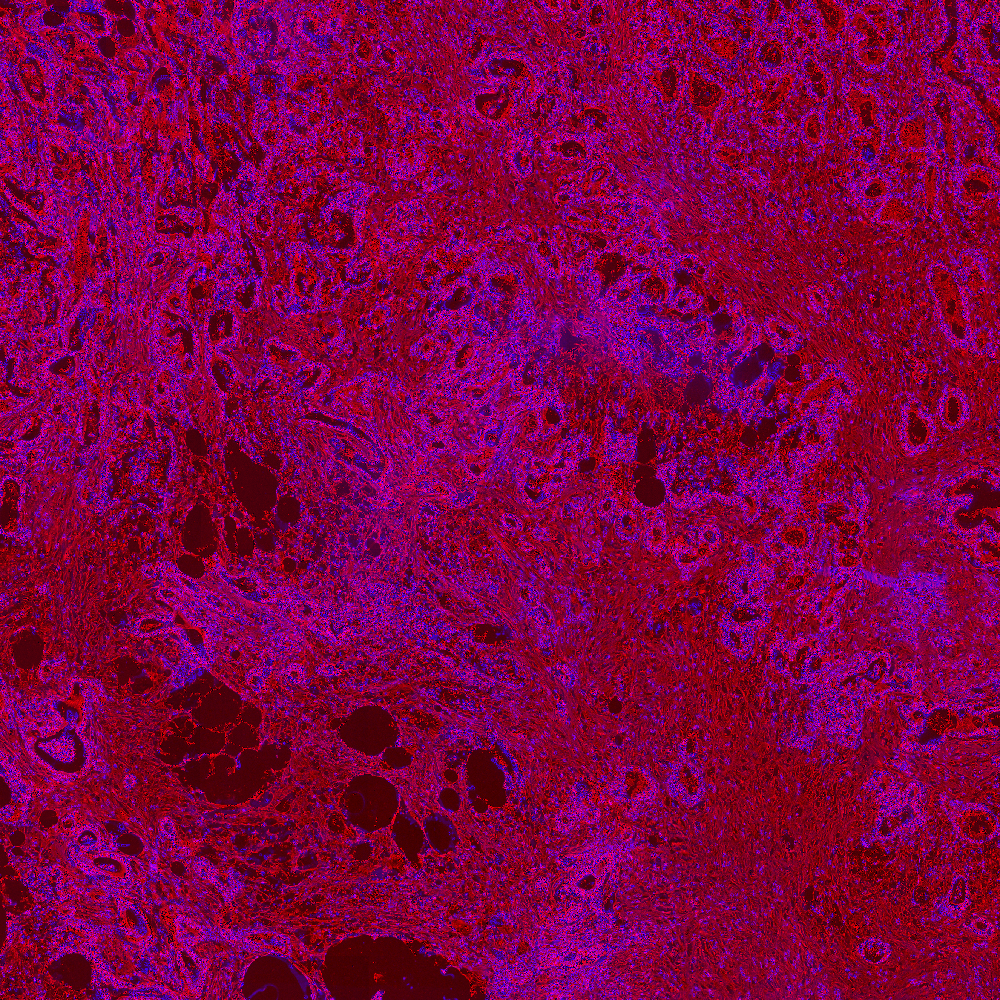

In [16]:
from PIL import Image
ext_len = 200
crop_region = l_boxes[5]
img_out_roi = img_result[crop_region[1]-ext_len:crop_region[3]+ext_len, crop_region[0]-ext_len:crop_region[2]+ext_len]
Image.fromarray(2*img_out_roi)

Text(0.5, 1.0, 'Crop region: [7418, 5573, 9670, 7825]')

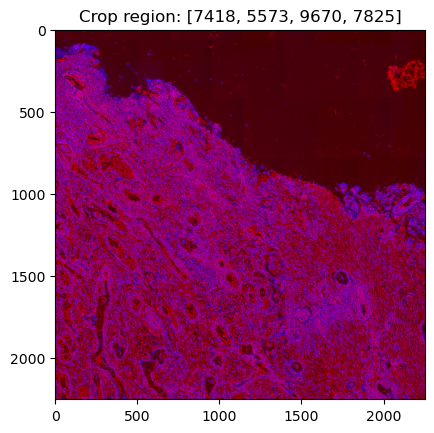

In [12]:
crop_region = l_boxes[2] #(3000, 9000, 5000, 11000)
img_out_roi = img_result[crop_region[1]:crop_region[3], crop_region[0]:crop_region[2]]
plt.imshow(2*img_out_roi)
plt.title(f"Crop region: {crop_region}")

In [13]:
crop_region = (11500, 9000, 13500, 11000)
disp = torch.load(f"disp_{crop_region[0]}_{crop_region[1]}.pth")
disp_all = disp_merged[:, crop_region[1]:crop_region[3], crop_region[0]:crop_region[2], :]

Text(0.5, 1.0, 'Crop region: (11500, 9000, 13500, 11000)')

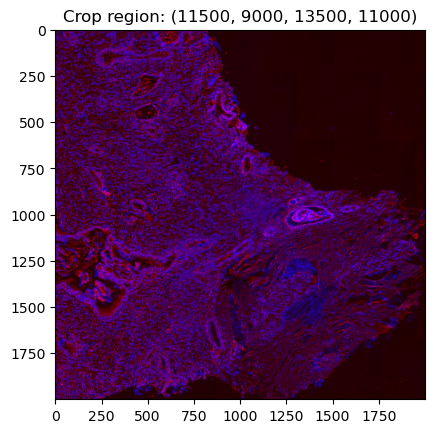

In [14]:
crop_region = (11500, 9000, 13500, 11000)
img_out_roi = img_result[crop_region[1]:crop_region[3], crop_region[0]:crop_region[2]]
plt.imshow(img_out_roi)
plt.title(f"Crop region: {crop_region}")